In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go

In [2]:
path= "../data/processed/BVSP_returns.xlsx"
df = pd.read_excel(path).loc[:,["datetime", "r_t"]]
df

,datetime,r_t
0,2025-05-09 10:05:00,0.001650
1,2025-05-09 10:10:00,0.000186
2,2025-05-09 10:15:00,0.000668
3,2025-05-09 10:20:00,0.000016
4,2025-05-09 10:25:00,-0.000888
...,...,...
11469,2025-11-14 16:40:00,-0.000255
11470,2025-11-14 16:45:00,0.000344
11471,2025-11-14 16:50:00,0.000202
11472,2025-11-14 16:55:00,-0.000096


In [3]:
df["date"] = df["datetime"].dt.date
df["time"] = df["datetime"].dt.time

In [4]:
# pivot to wide format
returns = df.pivot(index="time", columns="date", values="r_t")
returns.fillna(returns.mean(axis=0).mean(), inplace=True)
returns

date,2025-05-09,2025-05-12,2025-05-13,2025-05-14,2025-05-15,2025-05-16,2025-05-19,2025-05-20,2025-05-21,2025-05-22,...,2025-11-03,2025-11-04,2025-11-05,2025-11-06,2025-11-07,2025-11-10,2025-11-11,2025-11-12,2025-11-13,2025-11-14
time,,,,,,,,,,,,,,,,,,,,,
10:00:00,0.000013,0.000401,0.001025,-0.000209,0.000191,-0.000640,-0.000567,-0.000059,-0.001468,0.000029,...,0.001345,-0.002193,0.000625,0.000521,-0.001515,0.001599,0.000816,0.000196,0.002274,-0.000096
10:05:00,0.001650,0.005783,0.001332,-0.001808,0.000190,-0.001614,-0.000080,-0.000137,-0.001692,0.002553,...,-0.000321,-0.000972,-0.001265,0.003632,-0.000195,0.005056,0.006151,0.000495,-0.002867,-0.001522
10:10:00,0.000186,-0.000437,0.000390,0.002208,0.000190,-0.001185,-0.000437,-0.001313,-0.000154,-0.001663,...,0.002498,0.000560,0.001152,0.000606,-0.001242,-0.000751,0.001339,0.000735,0.001060,0.000360
10:15:00,0.000668,-0.001724,0.001835,-0.000394,0.000190,-0.006405,0.000428,-0.000951,0.001047,0.000068,...,-0.000294,0.000643,-0.001085,-0.000445,0.001988,-0.000856,0.000798,-0.001151,0.001413,0.001121
10:20:00,0.000016,-0.001247,0.002284,0.001109,0.000190,-0.000040,0.000025,0.000930,-0.000055,-0.000076,...,-0.001736,0.000064,0.001857,0.000817,-0.000308,0.001132,0.001468,0.000986,0.002795,0.000449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16:40:00,-0.000039,-0.000938,-0.000470,0.000057,-0.000368,0.000067,-0.000349,-0.000076,0.000669,-0.001386,...,-0.000122,0.000241,0.000255,-0.000271,0.000430,0.000039,-0.000065,0.000142,0.000203,-0.000255
16:45:00,-0.000039,0.000531,-0.000194,-0.000237,0.000397,0.000127,-0.000465,0.000693,-0.000347,0.001025,...,-0.000065,-0.000180,0.000823,-0.000248,-0.000110,-0.000466,-0.000082,-0.000357,0.000451,0.000344
16:50:00,0.000682,0.000195,-0.000471,-0.000051,0.000595,0.000073,0.000453,0.000765,-0.000744,-0.000042,...,-0.000165,0.000297,0.000286,-0.000213,0.000096,-0.000206,-0.000021,0.000619,0.000242,0.000202


In [5]:
from scipy.stats import gaussian_kde

In [6]:
df_returns = pd.read_excel("../data/processed/BVSP_returns_wide.xlsx", index_col="time")
# df_returns.drop(columns="time", inplace=True)
df_returns

,2025-05-09,2025-05-12,2025-05-13,2025-05-14,2025-05-15,2025-05-16,2025-05-19,2025-05-20,2025-05-21,2025-05-22,...,2025-11-03,2025-11-04,2025-11-05,2025-11-06,2025-11-07,2025-11-10,2025-11-11,2025-11-12,2025-11-13,2025-11-14
time,,,,,,,,,,,,,,,,,,,,,
10:00:00,0.000013,0.000401,0.001025,-0.000209,0.000191,-0.000640,-0.000567,-0.000059,-0.001468,0.000029,...,0.001345,-0.002193,0.000625,0.000521,-0.001515,0.001599,0.000816,0.000196,0.002274,-0.000096
10:05:00,0.001650,0.005783,0.001332,-0.001808,0.000190,-0.001614,-0.000080,-0.000137,-0.001692,0.002553,...,-0.000321,-0.000972,-0.001265,0.003632,-0.000195,0.005056,0.006151,0.000495,-0.002867,-0.001522
10:10:00,0.000186,-0.000437,0.000390,0.002208,0.000190,-0.001185,-0.000437,-0.001313,-0.000154,-0.001663,...,0.002498,0.000560,0.001152,0.000606,-0.001242,-0.000751,0.001339,0.000735,0.001060,0.000360
10:15:00,0.000668,-0.001724,0.001835,-0.000394,0.000190,-0.006405,0.000428,-0.000951,0.001047,0.000068,...,-0.000294,0.000643,-0.001085,-0.000445,0.001988,-0.000856,0.000798,-0.001151,0.001413,0.001121
10:20:00,0.000016,-0.001247,0.002284,0.001109,0.000190,-0.000040,0.000025,0.000930,-0.000055,-0.000076,...,-0.001736,0.000064,0.001857,0.000817,-0.000308,0.001132,0.001468,0.000986,0.002795,0.000449
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16:40:00,-0.000039,-0.000938,-0.000470,0.000057,-0.000368,0.000067,-0.000349,-0.000076,0.000669,-0.001386,...,-0.000122,0.000241,0.000255,-0.000271,0.000430,0.000039,-0.000065,0.000142,0.000203,-0.000255
16:45:00,-0.000039,0.000531,-0.000194,-0.000237,0.000397,0.000127,-0.000465,0.000693,-0.000347,0.001025,...,-0.000065,-0.000180,0.000823,-0.000248,-0.000110,-0.000466,-0.000082,-0.000357,0.000451,0.000344
16:50:00,0.000682,0.000195,-0.000471,-0.000051,0.000595,0.000073,0.000453,0.000765,-0.000744,-0.000042,...,-0.000165,0.000297,0.000286,-0.000213,0.000096,-0.000206,-0.000021,0.000619,0.000242,0.000202


In [7]:
# 1) Global support
global_min = df_returns.min().min()
global_max = df_returns.max().max()

m = 3000
u = np.linspace(global_min, global_max, m)

# 2) Prepare density matrix (m × T)
df_densities = pd.DataFrame(index=u, columns=df_returns.columns)

# 3) KDE for each day evaluated on a common support
for t in df_returns.columns:
    kde = gaussian_kde(df_returns[t])
    df_densities[t] = kde(u)

In [26]:
df_densities

,2025-05-09,2025-05-12,2025-05-13,2025-05-14,2025-05-15,2025-05-16,2025-05-19,2025-05-20,2025-05-21,2025-05-22,...,2025-11-03,2025-11-04,2025-11-05,2025-11-06,2025-11-07,2025-11-10,2025-11-11,2025-11-12,2025-11-13,2025-11-14
-0.010323,1.711039e-290,6.488436e-111,1.401400e-178,3.759331e-203,6.816199e-214,2.961104e-18,5.689170e-234,1.587455e-181,1.750181e-157,6.699048e-55,...,2.173340e-176,1.898166e-303,1.002446e-227,6.988181e-271,1.290040e-218,7.227437e-163,3.756730e-94,1.438911e-204,1.213045e-86,1.532485e-132
-0.010316,4.922276e-290,9.750348e-111,2.667176e-178,7.979037e-203,1.566329e-213,3.437162e-18,1.360143e-233,3.091578e-181,3.198271e-157,8.667760e-55,...,4.233368e-176,6.157135e-303,2.214961e-227,1.772924e-270,2.821983e-218,1.281119e-162,5.390182e-94,3.180056e-204,1.751315e-86,2.523398e-132
-0.010309,1.414849e-289,1.464737e-110,5.073678e-178,1.692497e-202,3.596821e-213,3.988719e-18,3.249483e-233,6.017671e-181,5.841581e-157,1.121211e-54,...,8.241518e-176,1.995232e-302,4.891151e-227,4.494843e-270,6.169383e-218,2.269892e-162,7.731550e-94,7.023381e-204,2.527583e-86,4.153351e-132
-0.010302,4.063423e-289,2.199675e-110,9.646633e-178,3.587920e-202,8.253724e-213,4.627578e-18,7.757795e-233,1.170702e-180,1.066420e-156,1.449954e-54,...,1.603582e-175,6.459191e-302,1.079434e-226,1.138774e-269,1.347923e-217,4.020050e-162,1.108663e-93,1.550131e-203,3.646701e-86,6.833372e-132
-0.010295,1.166036e-288,3.302303e-110,1.833202e-177,7.601427e-202,1.892677e-212,5.367364e-18,1.850788e-232,2.276322e-180,1.945849e-156,1.874595e-54,...,3.118443e-175,2.088974e-301,2.380792e-226,2.883098e-269,2.943232e-217,7.116533e-162,1.589287e-93,3.419014e-203,5.259551e-86,1.123815e-131
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0.010149,2.655135e-279,2.476846e-28,4.767658e-144,1.210775e-176,2.249178e-241,4.013731e-66,2.137030e-207,2.694908e-141,4.022068e-190,6.494942e-50,...,3.926483e-148,0.000000e+00,1.288853e-179,1.773374e-136,1.339875e-187,3.773315e-52,6.371291e-22,2.788422e-191,2.687440e-84,1.149253e-119
0.010156,9.413052e-280,2.013623e-28,2.673028e-144,5.997666e-177,9.287773e-242,3.026393e-66,9.398775e-208,1.495677e-141,2.072195e-190,5.078581e-50,...,2.129876e-148,0.000000e+00,6.367717e-180,9.146873e-137,6.483908e-188,2.725877e-52,5.345817e-22,1.294244e-191,1.870123e-84,7.151680e-120
0.010163,3.334358e-280,1.636503e-28,1.497902e-144,2.969195e-177,3.832611e-242,2.281337e-66,4.130723e-208,8.296620e-142,1.067074e-190,3.970050e-50,...,1.154696e-148,0.000000e+00,3.144158e-180,4.714586e-137,3.135779e-188,1.968340e-52,4.484051e-22,6.003225e-192,1.300934e-84,4.448604e-120
0.010170,1.180136e-280,1.329581e-28,8.389678e-145,1.469037e-177,1.580422e-242,1.719255e-66,1.814159e-208,4.599750e-142,5.492141e-191,3.102674e-50,...,6.256676e-149,0.000000e+00,1.551547e-180,2.428361e-137,1.515619e-188,1.420707e-52,3.760077e-22,2.782682e-192,9.046781e-85,2.766069e-120


In [25]:
np.where(df_densities.values ==0)

(array([   0,    0,    0, ..., 2999, 2999, 2999], shape=(2604,)),
 array([ 39,  59,  79, ...,  86,  97, 126], shape=(2604,)))

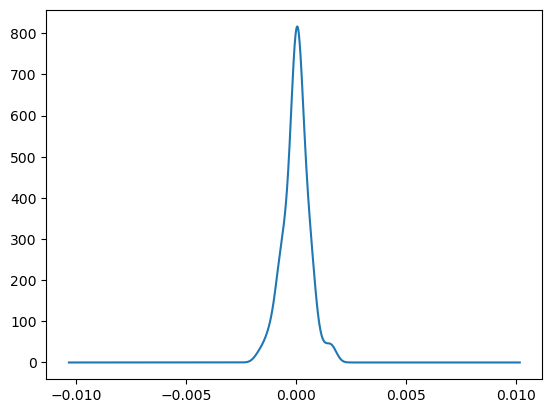

In [9]:
import matplotlib.pyplot as plt

plt.figure()

plt.plot(df_densities.index.values, df_densities.iloc[:,0])

plt.show()

In [10]:
def plot_2d_fts(df : pd.DataFrame, x: np.array, title_="Functional time series", alpha_=0.1):
    """
    df (pd.Dataframe): Dataframe with only function values where columns are functional objects and rows are grid points.
    x  (np.array): numpy array of x axis values

    ex: plot_2d_fts(df_densities, x=df_densities.index.values, title_ = "Densities over time")
    """
    cols = df.columns

    plt.figure(figsize=(15,5))
    for col in cols:
        plt.plot(x, df.loc[:, col], c="gray", alpha=alpha_)
    pointwise_mean = df.mean(axis=1)
    plt.plot(x, pointwise_mean, c="red", label="Point-wise mean")

    plt.title(title_)
    plt.legend()

    plt.show()

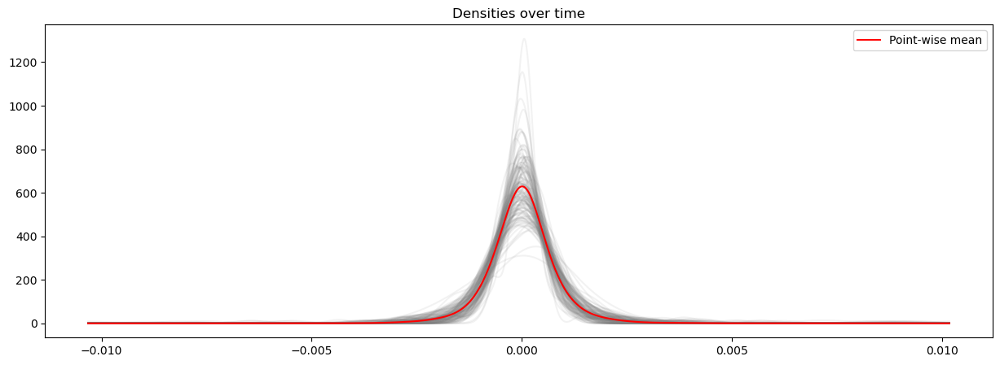

In [11]:
plot_2d_fts(df_densities, x=df_densities.index.values, title_ = "Densities over time")

In [12]:
n = df_densities.shape[1]
M = df_densities.shape[0] # number of gridpoints for LQD functions - chosen large here so that 0 isn't too close to the boundary of all supports
# u = seq(from = -0.01032280959030984, to = 0.01017648430576656, length = M)
u = df_densities.index.values
# lqd = matrix(0, nrow = M, ncol = n)
# c = rep(0, 1, n)
t = np.linspace(0, 1, M)
t0 = u[np.argmin(np.abs(u))] # closest value to 0

In [13]:
import numpy as np
from scipy.interpolate import interp1d
from scipy.integrate import cumulative_trapezoid, trapezoid


def dens2lqd(dens, dSup, lqdSup=None, t0=None, verbose=True):
    dens = np.asarray(dens)
    dSup = np.asarray(dSup)

    # Default t0
    if t0 is None:
        t0 = dSup[0]

    # ---- Check density requirements ----
    if np.any(dens < 0):
        raise ValueError("Please correct negative density values.")

    if abs(trapezoid(dens, dSup) - 1) > 1e-5:
        if verbose:
            print("Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.")
        dens = dens / trapezoid(dens, dSup)

    # ---- Handle zero density values by truncating support ----
    if np.any(dens == 0):
        if verbose:
            print("There are some zero density values - truncating support grid so all are positive")

        positive_idx = np.where(dens > 0)[0]
        lbd, ubd = positive_idx[0], positive_idx[-1]

        dens = dens[lbd:ubd+1]
        dSup = dSup[lbd:ubd+1]

        dens = dens / trapezoid(dens, dSup)

    N = len(dSup)

    # ---- Check LQD output grid ----
    if lqdSup is None:
        lqdSup = np.linspace(0, 1, N)
    else:
        lqdSup = np.asarray(lqdSup)
        if not (np.isclose(lqdSup.min(), 0) and np.isclose(lqdSup.max(), 1)):
            if verbose:
                print("Problem with support of the LQD domain’s boundaries - resetting to default.")
            lqdSup = np.linspace(0, 1, N)

    # ---- Check t0 ----
    if t0 not in dSup:
        if verbose:
            print("t0 is not a value in dSup - resetting to closest value")
        t0 = dSup[np.argmin(np.abs(dSup - t0))]

    M = len(lqdSup)
    c_ind = np.where(dSup == t0)[0][0]

    # ---- Compute CDF and constant c ----
    tmp = cumulative_trapezoid(dens, dSup, initial=0)
    c = tmp[c_ind]

    # ---- Remove duplicated CDF values (monotonicity issues in KDE) ----
    left_dup  = np.concatenate([np.diff(tmp[:N//2]) == 0, [False]])
    right_dup = np.concatenate([[False], np.diff(tmp[N//2:]) == 0])

    # NOTE: In R: !c(indL, indR)
    keep = ~(np.concatenate([left_dup, right_dup]))

    qtemp = tmp[keep]
    lqd_temp = -np.log(dens[keep])

    # ---- Interpolate lqd on the desired LQD support ----
    lqd = np.zeros(M)

    # Handle infinite boundary values
    temp_first_inf = np.isinf(lqd_temp[0])
    temp_last_inf = np.isinf(lqd_temp[-1])

    if temp_first_inf or temp_last_inf:

        tmpInd = np.arange(len(qtemp))
        Ind = np.arange(M)

        if temp_first_inf:
            lqd[0] = np.inf
            tmpInd = tmpInd[1:]
            Ind = Ind[1:]

        if temp_last_inf:
            lqd[-1] = np.inf
            tmpInd = tmpInd[:-1]
            Ind = Ind[:-1]

        interp = interp1d(qtemp[tmpInd], lqd_temp[tmpInd],
                          kind="linear", fill_value="extrapolate")
        lqd[Ind] = interp(lqdSup[Ind])

    else:
        interp = interp1d(qtemp, lqd_temp, kind="linear",
                          fill_value="extrapolate")
        lqd = interp(lqdSup)

    return lqdSup, lqd, c

In [14]:
_, lqd, _ = dens2lqd(df_densities.values[:,0], dSup = df_densities.index.values, lqdSup=t, t0=t0)

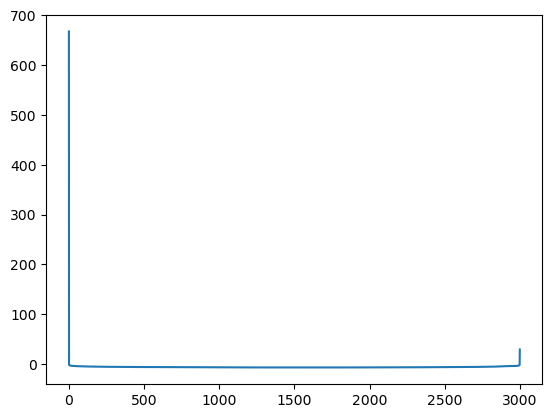

In [15]:
import matplotlib.pyplot as plt
plt.figure()

plt.plot(lqd)

plt.show()

In [16]:
df_lqds = []
c_values = []
for t_index,  density in enumerate(df_densities.columns):
    lqd_support, lqd, c = dens2lqd(df_densities.loc[:,density], dSup = df_densities.index.values, lqdSup=t, t0=t0)
    df_lqds.append(lqd)
    c_values.append(c)

Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
There are some zero density values - truncating support grid so all are positive
There are some zero density values - truncating support grid so all are positive
There are some zero density values - truncating support grid so all are positive
Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
Density does not integrate to 1 with tolerance 1e-5 - renormalizing now.
There are some zero density values - truncating support grid so all are positive
There are some zero density values - truncating support grid so all are positive
There are some zero density values - truncating support grid so all are positive
There are some zero density values - truncating support grid so all are posi

c:\Users\mathe\anaconda3\envs\densities4risk\Lib\site-packages\scipy\interpolate\_interpolate.py:497: RuntimeWarning: overflow encountered in divide
  slope = (y_hi - y_lo) / (x_hi - x_lo)[:, None]
c:\Users\mathe\anaconda3\envs\densities4risk\Lib\site-packages\scipy\interpolate\_interpolate.py:500: RuntimeWarning: invalid value encountered in multiply
  y_new = slope*(x_new - x_lo)[:, None] + y_lo


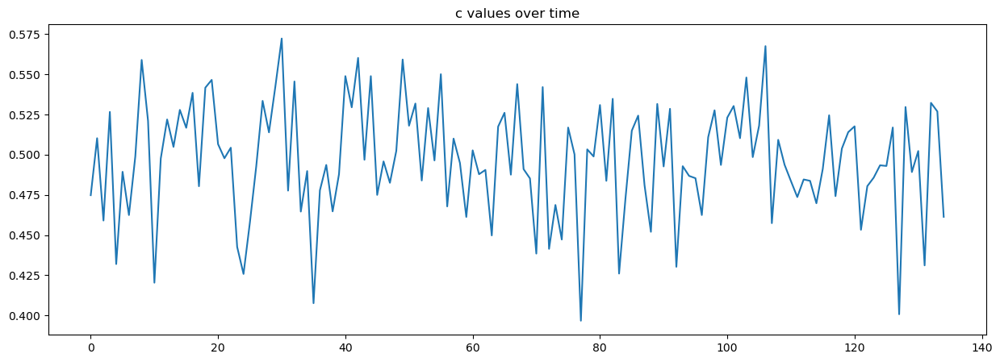

In [17]:
plt.figure(figsize=(15,5))

plt.plot(range(t_index+1), c_values)
plt.title("c values over time")

plt.show()

In [18]:
df_lqds = pd.DataFrame(np.vstack(df_lqds)).T
df_lqds.columns = df_densities.columns
df_lqds

,2025-05-09,2025-05-12,2025-05-13,2025-05-14,2025-05-15,2025-05-16,2025-05-19,2025-05-20,2025-05-21,2025-05-22,...,2025-11-03,2025-11-04,2025-11-05,2025-11-06,2025-11-07,2025-11-10,2025-11-11,2025-11-12,2025-11-13,2025-11-14
0,667.212576,253.716924,409.522675,466.100533,490.833908,40.360970,537.066347,416.305770,360.946141,124.740215,...,404.478711,697.042395,522.684373,622.056340,501.708877,373.343486,215.119450,469.363473,197.829184,303.514342
1,-1.184242,-0.841562,-0.936823,-1.041157,-1.085150,-0.588964,-1.086080,-1.002067,-0.996854,-0.590929,...,-1.008799,-1.256287,-1.125796,-1.246000,-1.077597,-0.882048,-0.692082,-1.058557,-0.722621,-0.920699
2,-1.757972,-1.447101,-1.511739,-1.621210,-1.648926,-1.151609,-1.649059,-1.593971,-1.599853,-1.153829,...,-1.593039,-1.819098,-1.733445,-1.856471,-1.674495,-1.472019,-1.271807,-1.621411,-1.289679,-1.520777
3,-2.081714,-1.795385,-1.835977,-1.949817,-1.962366,-1.463676,-1.961349,-1.932704,-1.947267,-1.466275,...,-1.924479,-2.131182,-2.083361,-2.207511,-2.017871,-1.812092,-1.599713,-1.933470,-1.606539,-1.864937
4,-2.304731,-2.039393,-2.059268,-2.176849,-2.174620,-1.674304,-2.172370,-2.169338,-2.191303,-1.677385,...,-2.153273,-2.342040,-2.328249,-2.454041,-2.258197,-2.051576,-1.825952,-2.144173,-1.822592,-2.105308
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,-2.412320,-1.783506,-2.096966,-2.095392,-2.302764,-1.674688,-2.172794,-2.050118,-2.369956,-1.676821,...,-2.140003,-2.502523,-2.296860,-2.164393,-2.195141,-1.932205,-1.744874,-2.144129,-1.900491,-2.049912
2996,-2.181546,-1.572841,-1.864496,-1.884867,-2.068286,-1.463910,-1.961635,-1.834049,-2.119394,-1.465984,...,-1.912303,-2.272518,-2.061255,-1.953695,-1.963123,-1.721510,-1.534177,-1.933562,-1.670614,-1.814631
2997,-1.848033,-1.260783,-1.531232,-1.572507,-1.731287,-1.151741,-1.649134,-1.517046,-1.762635,-1.153715,...,-1.582452,-1.939558,-1.722432,-1.641537,-1.629830,-1.409398,-1.222051,-1.621514,-1.338849,-1.476553
2998,-1.259537,-0.698163,-0.947396,-1.009810,-1.141352,-0.589030,-1.086134,-0.949822,-1.144977,-0.590992,...,-1.000346,-1.351356,-1.127539,-1.078941,-1.045372,-0.846837,-0.659465,-1.058514,-0.755131,-0.884562


In [ ]:
def plot_3d_fts(df: pd.DataFrame, f_domain: np.array, time_index: np.array, title_="Functional Time Series", axis_titles=["x","y","z"]):
    """
    ex: plot_3d_fts(df_lqds.iloc[1:-1,:], t[1:-1], df_lqds.columns, title_="LQDensities", axis_titles=["u", "Day", "LQDensity"])
    """
    domain = f_domain
    T = time_index
    image = [df.iloc[:,col] for col in range(df.shape[1])]

    fig = go.Figure(data=[go.Surface(
        x=domain, 
        y=T,
        z=image,  
        colorscale='Turbo'
    )])

    fig.update_layout(
        # title='Daily Kernel Density Estimates of Log Returns',
        scene=dict(
            xaxis_title=axis_titles[0],
            yaxis_title=axis_titles[1],
            zaxis_title=axis_titles[2],
        ),
        height=700,
        scene_camera=dict(
            eye=dict(x=0.7, y=2.0, z=0.8)  # change these values to rotate
        ),
        title={
            'text': title_,
            'x': 0.5,  # Center horizontally
            'xanchor': 'center'
        }
    )

    fig.show()
    

In [20]:
df_lqds.iloc[1:-1,:]

,2025-05-09,2025-05-12,2025-05-13,2025-05-14,2025-05-15,2025-05-16,2025-05-19,2025-05-20,2025-05-21,2025-05-22,...,2025-11-03,2025-11-04,2025-11-05,2025-11-06,2025-11-07,2025-11-10,2025-11-11,2025-11-12,2025-11-13,2025-11-14
1,-1.184242,-0.841562,-0.936823,-1.041157,-1.085150,-0.588964,-1.086080,-1.002067,-0.996854,-0.590929,...,-1.008799,-1.256287,-1.125796,-1.246000,-1.077597,-0.882048,-0.692082,-1.058557,-0.722621,-0.920699
2,-1.757972,-1.447101,-1.511739,-1.621210,-1.648926,-1.151609,-1.649059,-1.593971,-1.599853,-1.153829,...,-1.593039,-1.819098,-1.733445,-1.856471,-1.674495,-1.472019,-1.271807,-1.621411,-1.289679,-1.520777
3,-2.081714,-1.795385,-1.835977,-1.949817,-1.962366,-1.463676,-1.961349,-1.932704,-1.947267,-1.466275,...,-1.924479,-2.131182,-2.083361,-2.207511,-2.017871,-1.812092,-1.599713,-1.933470,-1.606539,-1.864937
4,-2.304731,-2.039393,-2.059268,-2.176849,-2.174620,-1.674304,-2.172370,-2.169338,-2.191303,-1.677385,...,-2.153273,-2.342040,-2.328249,-2.454041,-2.258197,-2.051576,-1.825952,-2.144173,-1.822592,-2.105308
5,-2.473327,-2.226489,-2.227897,-2.348963,-2.331852,-1.829623,-2.328004,-2.350494,-2.379102,-1.833318,...,-2.326708,-2.497145,-2.516461,-2.642854,-2.442960,-2.236858,-1.997139,-2.299655,-1.983930,-2.289683
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2994,-2.587039,-1.938855,-2.274813,-2.250844,-2.482032,-1.830203,-2.328750,-2.211487,-2.562801,-1.832378,...,-2.312427,-2.676661,-2.475604,-2.319789,-2.372358,-2.087549,-1.900213,-2.299514,-2.075292,-2.229494
2995,-2.412320,-1.783506,-2.096966,-2.095392,-2.302764,-1.674688,-2.172794,-2.050118,-2.369956,-1.676821,...,-2.140003,-2.502523,-2.296860,-2.164393,-2.195141,-1.932205,-1.744874,-2.144129,-1.900491,-2.049912
2996,-2.181546,-1.572841,-1.864496,-1.884867,-2.068286,-1.463910,-1.961635,-1.834049,-2.119394,-1.465984,...,-1.912303,-2.272518,-2.061255,-1.953695,-1.963123,-1.721510,-1.534177,-1.933562,-1.670614,-1.814631
2997,-1.848033,-1.260783,-1.531232,-1.572507,-1.731287,-1.151741,-1.649134,-1.517046,-1.762635,-1.153715,...,-1.582452,-1.939558,-1.722432,-1.641537,-1.629830,-1.409398,-1.222051,-1.621514,-1.338849,-1.476553


In [23]:
plot_3d_fts(df_lqds.iloc[1:-1,:], t[1:-1], df_lqds.columns, title_="LQDensities", axis_titles=["u", "Day", "LQDensity"])

In [64]:
# problema de valores próximos ao limite

In [22]:
df_lqds.min().min()

-7.175514926409708

In [23]:
df_lqds.max().max()

52635691.52607356

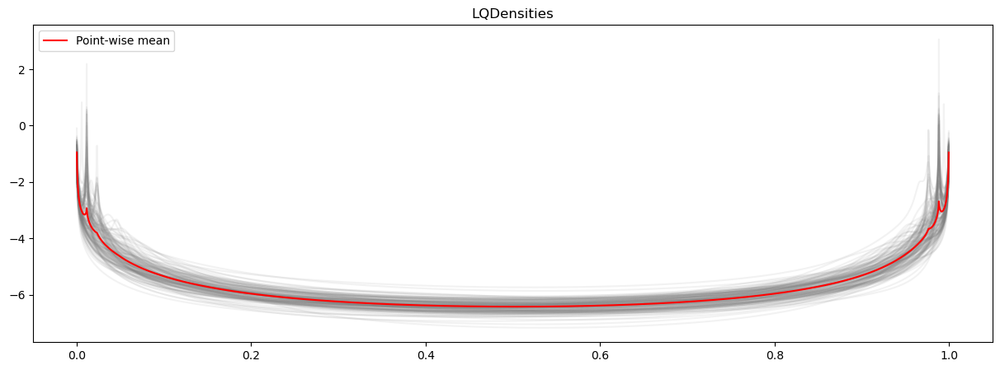

In [24]:
plt.figure(figsize=(15,5))

for i in range(df_lqds.shape[1]):
    plt.plot(t[1:-1],df_lqds.iloc[1:-1,i], c='gray', alpha=0.1)

plt.plot(t[1:-1], df_lqds.iloc[1:-1,:].mean(axis=1), c="red", label = "Point-wise mean")

plt.title("LQDensities")
plt.legend()

plt.show()

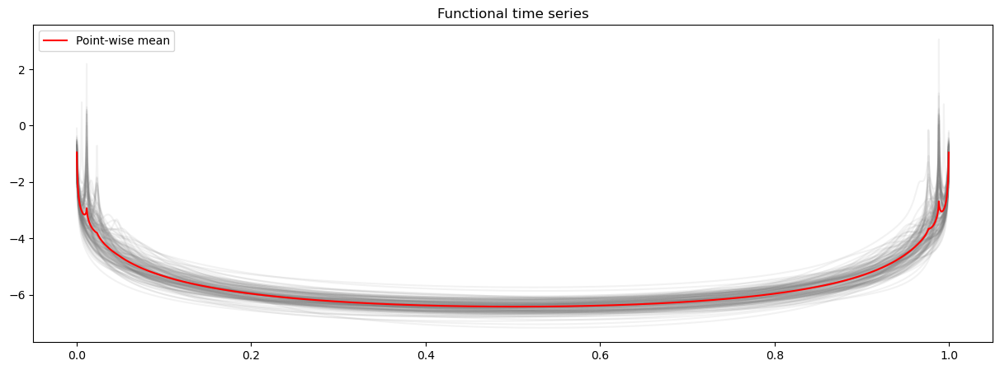

In [25]:
plot_2d_fts(df_lqds.iloc[1:-1,:], t[1:-1])

In [26]:
lqds = [df_lqds.iloc[1:-1,lqd] for lqd in range(df_lqds.shape[1])]

In [27]:
fig = go.Figure(data=[go.Surface(
    x=t[1:-1],   # log return values
    y=df_lqds.columns,          # day index
    z=lqds,          # densities
    colorscale='Turbo'
)])

fig.update_layout(
    # title='Daily Kernel Density Estimates of Log Returns',
    scene=dict(
        xaxis_title='Log return',
        yaxis_title='Day',
        zaxis_title='Density',
    ),
    height=700,
    scene_camera=dict(
        eye=dict(x=0.7, y=2.0, z=0.8)  # change these values to rotate
    ),
    title={
        'text': "Daily Kernel Density Estimates of Log Returns",
        'x': 0.5,  # Center horizontally
        'xanchor': 'center'
    }
)

fig.show()

In [131]:
t[1:-1]

array([3.33444481e-04, 6.66888963e-04, 1.00033344e-03, ...,
       9.98999667e-01, 9.99333111e-01, 9.99666556e-01], shape=(2998,))

In [ ]:
fig = go.Figure(data=[go.Surface(
    x=Z,   # log return values
    y=Y,          # day index
    z=x_common,          # densities
    colorscale='Turbo'
)])

In [134]:
df_lqds2 = df_lqds.iloc[1:-1,:]
t2 = t[1:-1]

# Sort days and build aligned matrices
days_sorted = sorted(df_lqds2.columns)

# ---- Step 1: build a common X grid (important for smooth 3D surface)
# all_x = np.concatenate([kdes[d]["x_grid"] for d in days_sorted])
x_common = t2

# ---- Step 2: evaluate each day's KDE on the common grid
# Z = []
# for d in days_sorted:
#     kde = kdes[d]["x_grid"]
#     density = kdes[d]["y_kde"]
#     # Interpolate densities to common x grid
#     z_interp = np.interp(x_common, kde, density)
#     Z.append(z_interp)

Z = df_lqds2
Y = np.arange(len(days_sorted))  # day index

# ---- Step 3: create 3D surface
fig = go.Figure(data=[go.Surface(
    x=Z,   # log return values
    y=Y,          # day index
    z=x_common,          # densities
    colorscale='Turbo'
)])

# ---- Step 4: layout and labels
# fig.update_layout(
#     # title='Daily Kernel Density Estimates of Log Returns',
#     scene=dict(
#         xaxis_title='Log return',
#         yaxis_title='Day',
#         zaxis_title='Density',
#         yaxis=dict(
#             tickmode='array',
#             tickvals=np.linspace(0, len(days_sorted)-1, 10, dtype=int),
#             ticktext=[str(days_sorted[i]) for i in np.linspace(0, len(days_sorted)-1, 10, dtype=int)]
#         )
#     ),
#     height=700,
#     scene_camera=dict(
#         eye=dict(x=0.7, y=2.0, z=0.8)  # change these values to rotate
#     ),
#     title={
#         'text': "Daily Kernel Density Estimates of Log Returns",
#         'x': 0.5,  # Center horizontally
#         'xanchor': 'center'
#     }
# )


fig.show()

In [127]:
fig = go.Figure(data=[go.Surface(
    x=t,   # log return values
    y=df_lqds.columns,          # day index
    z=df_lqds.iloc[1:,0:100],          # densities
    # colorscale='Turbo'
)])

fig.show()

In [82]:
def plot_3d_fts(support, time_index, values):
    # kde_results = {day: (x_grid, y_kde)} from previous step

    # Sort days and build aligned matrices
    days_sorted = sorted(time_index)

    # ---- Step 1: build a common X grid (important for smooth 3D surface)
    x_common = support

    # ---- Step 2: evaluate each day's KDE on the common grid
    # Z = []
    # for d in days_sorted:
    #     kde = kdes[d]["x_grid"]
    #     density = kdes[d]["y_kde"]
    #     # Interpolate densities to common x grid
    #     z_interp = np.interp(x_common, kde, density)
    #     Z.append(z_interp)

    # Z = np.array(Z)
    Y = np.arange(len(days_sorted))  # day index

    # ---- Step 3: create 3D surface
    fig = go.Figure(data=[go.Surface(
        x=x_common,   # log return values
        y=Y,          # day index
        z=values,          # densities
        colorscale='Turbo'
    )])

    # ---- Step 4: layout and labels
    # fig.update_layout(
    #     # title='Daily Kernel Density Estimates of Log Returns',
    #     scene=dict(
    #         xaxis_title='Log return',
    #         yaxis_title='Day',
    #         zaxis_title='lqDensity',
    #         yaxis=dict(
    #             tickmode='array',
    #             tickvals=np.linspace(0, len(days_sorted)-1, 10, dtype=int),
    #             ticktext=[str(days_sorted[i]) for i in np.linspace(0, len(days_sorted)-1, 10, dtype=int)]
    #         )
    #     ),
    #     height=700,
    #     scene_camera=dict(
    #         eye=dict(x=0.7, y=2.0, z=0.8)  # change these values to rotate
    #     ),
    #     title={
    #         'text': "Daily Kernel Density Estimates of Log Returns",
    #         'x': 0.5,  # Center horizontally
    #         'xanchor': 'center'
    #     }
    # )


    fig.show()

In [84]:
df_lqds.values

array([[667.2125763 , 253.71692388, 409.52267458, ..., 469.36347253,
        197.82918448, 303.51434167],
       [ -1.18424226,  -0.84156158,  -0.93682251, ...,  -1.05855657,
         -0.72262121,  -0.92069907],
       [ -1.75797212,  -1.44710126,  -1.51173909, ...,  -1.62141148,
         -1.2896791 ,  -1.52077711],
       ...,
       [ -1.84803342,  -1.26078274,  -1.53123184, ...,  -1.62151394,
         -1.33884873,  -1.47655254],
       [ -1.25953712,  -0.69816315,  -0.94739626, ...,  -1.05851412,
         -0.75513089,  -0.88456176],
       [ 29.37142612,  24.81295345,  27.08787463, ...,  24.43431472,
         26.86155794,  24.78797006]], shape=(3000, 135))

In [83]:
plot_3d_fts(lqd_support, df_densities.columns, df_lqds.values)

In [ ]:
import numpy as np
from scipy.interpolate import interp1d, CubicSpline
from scipy.integrate import cumulative_trapezoid, quad, trapezoid


def lqd2dens(lqd, lqdSup=None, dSup=None, t0=0, c=0, useSplines=True,
             cut=None, verbose=True):

    lqd = np.asarray(lqd)

    # Default cut
    if cut is None:
        cut = [0, 0]

    # Default lqdSup
    if lqdSup is None:
        lqdSup = np.linspace(0, 1, len(lqd))
    else:
        lqdSup = np.asarray(lqdSup)
        if not (np.isclose(lqdSup.min(), 0) and np.isclose(lqdSup.max(), 1)):
            if verbose:
                print("Problem with support of the LQD domain's boundaries - resetting to default.")
            lqdSup = np.linspace(0, 1, len(lqd))

    M = len(lqd)

    # Identify infinite exp(lqd) values
    r = np.where(np.isinf(np.exp(lqd)))[0]

    if len(r) > 0:
        left = r[r < (M//2)]
        right = r[r >= (M//2)]

        if len(left) > 0:
            cut[0] = max(cut[0], left.max())
        if len(right) > 0:
            cut[1] = max(cut[1], M - right.min())

    # ------ Apply cutoff ------
    lqdSup = lqdSup[cut[0] : M - cut[1]]
    lqd = lqd[cut[0] : M - cut[1]]
    M = len(lqd)

    # ------ Ensure c is in support ------
    if c not in lqdSup:
        if c < lqdSup[0] or c > lqdSup[-1]:
            raise ValueError("c is not contained within range of lqdSup after cutoff")

        if verbose:
            print("c is not equal to a value in lqdSup - resetting to closest value")

        c = lqdSup[np.argmin(np.abs(lqdSup - c))]

    c_ind = np.where(lqdSup == c)[0][0]

    # ------ Compute dtemp from LQD ------
    if useSplines:
        # Natural cubic spline approximation of lqd(t)
        spline = CubicSpline(lqdSup, lqd, bc_type='natural')

        def lqd_exp(t):
            return np.exp(spline(t))

        # Build dtemp using numerical integration between grid points
        dtemp_vals = [0.0]
        for i in range(1, len(lqdSup)):
            val, _ = quad(lqd_exp, lqdSup[i-1], lqdSup[i])
            dtemp_vals.append(dtemp_vals[-1] + val)

        dtemp = t0 + np.array(dtemp_vals) - quad(lqd_exp, lqdSup[0], lqdSup[c_ind])[0]

    else:
        # Trapezoidal approximation
        dtemp = t0 + cumulative_trapezoid(np.exp(lqd), lqdSup, initial=0)
        dtemp -= trapezoid(np.exp(lqd[: c_ind+1]), lqdSup[: c_ind+1])

    # ------ Remove duplicates ------
    left_dup = np.concatenate([np.diff(dtemp[: M//2]) == 0, [False]])
    right_dup = np.concatenate([[False], np.diff(dtemp[M//2:]) == 0])

    keep = ~(np.concatenate([left_dup, right_dup]))

    dtemp = dtemp[keep]
    dens_temp = np.exp(-lqd[keep])

    # ------ Interpolate to new dSup ------
    dSup_new = np.linspace(dtemp[0], dtemp[-1], len(dtemp))

    interp = interp1d(dtemp, dens_temp, kind="linear", fill_value="extrapolate")
    dens = interp(dSup_new)

    # Normalize, accounting for truncated LQD domain
    dens = dens / trapezoid(dens, dSup_new) * (lqdSup[-1] - lqdSup[0])

    return {
        "dSup": dSup_new,
        "dens": dens
    }


In [ ]:
def T_q(
        density: np.array, 
        density_support: np.array, 
        lqd_support: np.array = None,
        t0 : int = None
        ) -> list[np.array, np.array, np.float64]:
    """Function for converting densities to log quantile density functions

    Args:
        density (np.array): density values on density_support - must be strictly positive (otherwise will truncate) and integrate to 1.
        density_support (np.array): support (grid) for Density domain.
        lqd_support (np.array, optional): support of length M for lqd domain - must begin at 0 and end at 1. Defaults to None.
        t0 (int, optional): value in density_support for which the cdf value c is retained, i.e. c = F(t0). Defaults to None.

    Returns:
        list[np.array, np.array, np.float64]: [lqd_support, lqd, c]

    Example:
        dens_support = np.linspace(0, 1, 512)
        dens = np.full(512, 0.5)
        lqd_support, lqd, c = T_q(density=dens, density_support=dens_support)
    """
    lqd_support = np.linspace(0,1, len(density_support))
    t0 = density_support[0]

    if np.any(density<0):
        raise Exception("There are negative density values")
    if np.abs(np.trapezoid(density, density_support) - 1) > 1e-5:
        warnings.warn("Density does not integrate to 1 with tolerance of 1e-5 - renormalizing now.")
        density = density/np.trapezoid(density, density_support)
    if np.any(density==0):  
        warnings.warn("There are some zero density values - truncating support grid so all are positive.")
        lower_bound = np.min(np.where(density>0))
        upper_bound = np.max(np.where(density>0))
        density_support = density_support[lower_bound : upper_bound]
        density = density/np.trapezoid(density, density_support) 
        
    N = len(density_support)

    if lqd_support is None:
        lqd_support = np.linspace(0,1,N)
    elif not (np.array([lqd_support.min(),lqd_support.max()]) == np.array([0,1])).all():
        warnings.warn(("Problem with support of the LQD domain's boundaries - resetting to default."))
        lqd_support = np.linspace(0,1,N)
        
    if not (t0 in density_support):
        warnings.warn("t0 is not a value in density_support - resetting to closest value")
        t0 = density_support[np.argmin((abs(density_support-t0)))]
    M = len(lqd_support)
    c_ind = np.where(density_support == t0)[0][0]

    # Get CDF and lqd on temporary grid, compute c
    tmp = integrate.cumulative_trapezoid(density, density_support, initial=0)
    c = tmp[c_ind]

    N_tmp = len(tmp)

    # ---- Left duplicates (forward scan)
    first_half = tmp[:N_tmp//2]
    _, indL = np.unique(first_half, return_index=True)
    maskL = np.ones(len(first_half), dtype=bool)
    maskL[np.setdiff1d(np.arange(len(first_half)), indL)] = False  # mark duplicates as False

    # ---- Right duplicates (reverse scan)
    second_half = tmp[N_tmp//2:]
    _, indR_rev = np.unique(second_half[::-1], return_index=True)
    maskR = np.ones(len(second_half), dtype=bool)
    maskR[np.setdiff1d(np.arange(len(second_half)), len(second_half) - 1 - indR_rev)] = False

    mask = np.concatenate([maskL, maskR])
    qtemp = tmp[mask]

    lqd_temp = -np.log(density[mask])

    # Interpolate lqd_support, keeping track of Inf values at boundary, then compute c
    lqd = np.full(M, 0)

    if np.any(np.isinf([lqd_temp[0], lqd_temp[N-1]])):
        tmpInd = np.arange(1, N)
        Ind = np.arange(1, M)
        if lqd_temp[0] == np.inf:
            lqd[0] = np.inf
            tmpInd = tmpInd[-1]
            Ind = Ind[-1]
        if lqd_temp[-1] == np.inf:
            lqd[M] = np.inf
            tmpInd = tmpInd[-len(tmpInd)]
            Ind = Ind[-len(Ind)]

        interp_values = np.interp(
            lqd_support[Ind-1],            # xout
            qtemp[tmpInd-1],               # x
            lqd_temp[tmpInd-1],            # y
            left=lqd_temp[tmpInd-1][0],    # rule = 2 → use endpoint values
            right=lqd_temp[tmpInd-1][-1]
        )

        lqd[Ind] = interp_values
    else:
        interp_values = np.interp(
            lqd_support,
            qtemp,
            lqd_temp,
            left=lqd_temp[0],    # rule = 2 → use endpoint values
            right=lqd_temp[-1]
        )
        lqd = interp_values

    return [lqd_support, lqd, c]

In [ ]:
path = r'..\data\processed\BVSP_returns_densities.xlsx'
df_densities = pd.read_excel(path)
df_densities

In [ ]:
lqds = pd.DataFrame()

densities = df_densities.iloc[:,1:]
for day in densities.columns:
    lqd = dens2lqd(df_densities.values[:,0], dSup = df_densities.index.values, lqdSup=t, t0=t0)["lqd"]
